**This is a downloaded version of our Colab notebook for archival purposes. We used the Colab notebook when doing the data exploration, so the code in this notebook is optimized for Colab.**

Instructions:
- Perform the data exploration step (i.e. evaluate your data, # of observations, details about your data distributions, scales, missing data, column descriptions) Note: For image data you can still describe your data by the number of classes, # of images, plot example classes of the image, size of images, are sizes uniform? Do they need to be cropped? normalized? etc.
- Plot your data. For tabular data, you will need to run scatters, for image data, you will need to plot your example classes.
- How will you preprocess your data? You should explain this in your README.md file and link your Jupyter notebook to it. All code and  Jupyter notebooks have be uploaded to your repo.

In [ ]:
!pip install pandas
!pip install opendatasets
!pip install Pillow

In [ ]:
import opendatasets as od
import pandas as pd

od.download(
    "https://www.kaggle.com/datasets/kacpergregorowicz/house-plant-species")

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: soy001
Your Kaggle Key: ··········
Dataset URL: https://www.kaggle.com/datasets/kacpergregorowicz/house-plant-species


100%|██████████| 4.85G/4.85G [00:56<00:00, 92.9MB/s]


### Import Necessary Libraries

In [ ]:
import os
from PIL import Image, ImageOps
import numpy as np
import pandas as pd
import random
from torchvision import transforms
from tqdm import tqdm
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt

#Data Exploration

### Column Descriptions

In [ ]:
# Set paths
data_dir = 'house-plant-species/house_plant_species/'  # Path where images are stored in subfolders by category
output_dir = 'processed_images/'    # Directory to save processed images by category
os.makedirs(output_dir, exist_ok=True)

# Create dataframe for plant categories

# Initialize a list to hold file paths and labels
file_paths = []
labels = []

# Loop through each category folder
for category in os.listdir(data_dir):
    category_path = os.path.join(data_dir, category)

    # Check if it's a directory
    if os.path.isdir(category_path):
        for img_file in os.listdir(category_path):
            file_paths.append(os.path.join(category_path, img_file))  # Full path to the image
            labels.append(category)  # Folder name is the label

# Create the DataFrame
labels_df = pd.DataFrame({
    'file_path': file_paths,
    'species': labels
})

print(labels_df.head())

                                           file_path   species
0  house-plant-species/house_plant_species/Dracae...  Dracaena
1  house-plant-species/house_plant_species/Dracae...  Dracaena
2  house-plant-species/house_plant_species/Dracae...  Dracaena
3  house-plant-species/house_plant_species/Dracae...  Dracaena
4  house-plant-species/house_plant_species/Dracae...  Dracaena


The file_path column holds the full file path to each image in the dataset. The species column corresponds to the species of each plant image. The species names are derived from the folder name containing the image, and serves as the label.

### Attributes of Dataset

In [ ]:
# Count the number of images per species
species_counts = labels_df['species'].value_counts()
print(species_counts.to_string())

# Total number of images
total_images = labels_df.shape[0]

# Total number of unique classes (species)
total_classes = labels_df['species'].nunique()

print(f"Total number of images: {total_images}")
print(f"Total number of classes (species): {total_classes}")

species
Monstera Deliciosa (Monstera deliciosa)       547
Dumb Cane (Dieffenbachia spp.)                541
Chinese evergreen (Aglaonema)                 514
Lilium (Hemerocallis)                         480
Anthurium (Anthurium andraeanum)              455
ZZ Plant (Zamioculcas zamiifolia)             438
Daffodils (Narcissus spp.)                    421
Lily of the valley (Convallaria majalis)      416
Prayer Plant (Maranta leuconeura)             400
Snake plant (Sanseviera)                      396
Peace lily                                    385
Chinese Money Plant (Pilea peperomioides)     382
Money Tree (Pachira aquatica)                 359
Jade plant (Crassula ovata)                   353
Ctenanthe                                     347
Polka Dot Plant (Hypoestes phyllostachya)     341
Tulip                                         341
Tradescantia                                  341
African Violet (Saintpaulia ionantha)         337
Elephant Ear (Alocasia spp.)              

### Check for Corrupted Files

In [ ]:
def check_images(directory):
    corrupted_files = []

    for subdir, dirs, files in os.walk(directory):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
                file_path = os.path.join(subdir, file)
                # Check if the image can be opened
                try:
                    img = Image.open(file_path)
                    img.verify()  # Verify that it is, in fact, an image
                except (IOError, SyntaxError) as e:
                    corrupted_files.append(file_path)
                    print(f"Corrupted file: {file_path}")

    return corrupted_files

# Specify the root directory of your image dataset
base_dir = 'house-plant-species/house_plant_species'
corrupted = check_images(base_dir)

print("Corrupted Files:", corrupted)


Corrupted Files: []


### Image Sizes

In [ ]:
def check_image_sizes(df):
    sizes = []

    # Loop through each image path in the DataFrame
    for img_path in df['file_path']:
        with Image.open(img_path) as img:
            sizes.append(img.size)  # (width, height)

    # Convert to a set to get unique sizes
    unique_sizes = set(sizes)

    if len(unique_sizes) == 1:
        print("All images are uniform in size:", unique_sizes.pop())
    else:
        print("Images have varying sizes.")
        print("Unique sizes:", unique_sizes)

# Check if images are uniform in size
check_image_sizes(labels_df)

Images have varying sizes.
Unique sizes: {(2160, 3183), (768, 515), (500, 435), (570, 759), (1076, 1305), (1200, 1600), (1687, 2362), (740, 416), (2600, 3900), (1468, 1500), (580, 580), (2820, 2820), (446, 500), (704, 1024), (750, 991), (1600, 1576), (1284, 1599), (960, 721), (1731, 1730), (1120, 1576), (767, 1080), (1600, 1167), (642, 640), (852, 895), (585, 780), (2375, 3000), (624, 1000), (1209, 1690), (1600, 1432), (1888, 2244), (2848, 4272), (900, 1200), (1280, 1570), (500, 592), (960, 842), (718, 900), (1024, 1235), (925, 884), (1600, 1288), (2024, 2024), (2048, 1149), (1355, 1600), (736, 539), (1080, 2335), (1536, 1532), (1920, 1000), (717, 1200), (1500, 1609), (1528, 1528), (2686, 4029), (994, 691), (640, 571), (750, 968), (1588, 2216), (3693, 2462), (1500, 1200), (2560, 2120), (1501, 1690), (982, 982), (818, 614), (794, 1160), (600, 800), (685, 1024), (1080, 1108), (1000, 999), (930, 1200), (6720, 4480), (184, 184), (418, 500), (744, 664), (1053, 1536), (1374, 2000), (1317, 12

### Example Classes

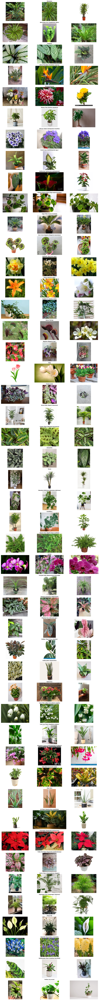

In [ ]:
def plot_example_images(df, num_classes=5, images_per_class=3):
    # Select the unique species (classes) and limit to num_classes if specified
    classes = df['species'].unique()[:num_classes]

    plt.figure(figsize=(15, 3 * num_classes))  # Adjust figure size to fit the number of rows

    # Loop through each class and plot a few example images
    for i, species in enumerate(classes):
        # Filter DataFrame for the current species and get a sample of images
        sample_images = df[df['species'] == species].sample(images_per_class)['file_path']

        for j, img_path in enumerate(sample_images):
            # Calculate subplot index
            plt_idx = i * images_per_class + j + 1
            plt.subplot(num_classes, images_per_class, plt_idx)

            # Open and display the image
            img = Image.open(img_path)
            plt.imshow(img)
            plt.axis('off')

            # Add species label as title once per row
            if j == 1:
                plt.title(species, fontsize=10, fontweight='bold')

    plt.tight_layout()
    plt.show()

# Plot 3 images for each of the example classes (adjust num_classes as needed)
plot_example_images(labels_df, num_classes=47, images_per_class=3)

## EDA